In [1]:
import itertools
import numpy as np
import os
import seaborn as sns
from tqdm import tqdm
from dataclasses import asdict, dataclass, field
import vsketch
import shapely.geometry as sg
from shapely.geometry import box, MultiLineString, Point, MultiPoint, Polygon, MultiPolygon, LineString
import shapely.affinity as sa
import shapely.ops as so
import matplotlib.pyplot as plt
import pandas as pd

import vpype_cli
from typing import List, Generic
from genpen import genpen as gp, utils as utils
from scipy import stats as ss
import geopandas
from shapely.errors import TopologicalError
import functools
%load_ext autoreload
%autoreload 2

# Try 7

In [2]:
paper_size = '7x5 inches'
border:float=10
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

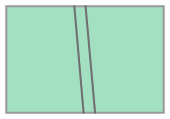

In [362]:
new, old = gp.split_poly(drawbox, gp.random_line_subdivide(drawbox, x0=0.87, x1=0.35))

bg_polys = [new] + gp.split_poly(old, gp.random_line_subdivide(old, x0=0.03, x1=0.69))

bg_right, bg_mid, bg_left = bg_polys
MultiPolygon(bg_polys)

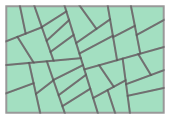

In [363]:
xgen = ss.uniform(loc=0.55, scale=0.1).rvs
split_func = functools.partial(gp.split_along_longest_side_of_min_rectangle, xgen=xgen)
splits = gp.recursive_split_frac_buffer(
    drawbox, 
    split_func=split_func,
    p_continue=0.99, 
    depth=0, 
    depth_limit=4,
    buffer_frac=-0.0
)

bps = MultiPolygon([p for p in splits])
bps

In [364]:
bg_bps_left = [so.unary_union([bp for bp in bps if bp.within(bg_left)]).buffer(0.1)]
bg_bps_right = [so.unary_union([bp for bp in bps if bp.within(bg_right)]).buffer(0.1)]

In [368]:
bg_bps_left = [bg_left]
bg_bps_right = [bg_right]
brush_left = [bg_left]

In [369]:
bg_layers = []
for bg_bps in [bg_bps_left, bg_bps_right, brush_left]:
    fills = []
    for p in bg_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.2, 1.)).rvs
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.2, 0.5),
            degrees=np.random.uniform(10, 40),
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=15,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    bg_layers.append(layer)

In [370]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(bg_layers):
    sk.stroke(i+1)
    sk.geometry(layer)

sk.penWidth('0.3')
for tolerance in [0.3, 0.6, 1.2]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-02-27T19:02:47.740034 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="265.2464,442.2047 248.605,436.0145 234.9991,431.2882 221.3267,426.8117 207.5927,422.5666 193.8044,418.5254 166.1029,410.9114 110.5054,396.4137 82.754,388.9874 37.7953,376.4453 37.7953,376.1198 82.8881,388.4839 110.6822,395.7501 166.3577,409.9548 194.0886,417.4584 207.8891,421.4537 221.6338,425.6589 235.3153,430.1013 248.9285,434.8001 268.7618,442.2047 269.4272,442.2047 249.015,434.4751 235.4231,429.6965 221.7654,425.1649 208.0459,420.8654 194.2709,416.7738 166.5903,409.0817 97.1199,390.8601 55.5752,379.411 37.7953,374.3489 37.7953,372.7755 83.66,385.5859 167.0072,407.5165 194.6836,415.2247 208.4565,419.3239 222.1746,423.6289 235.8316,428.163 249.4235,432.9416 262.9487,437.9708 273.7511,442.2047 276.9966,442.2047 263.2358,436.8931 249.6917,431.9347 236.0833,427.218 222.4129,422.734 208.6853,418.465 181.0872,410.4627 97.8464,388.1328 70.1735,380.4118 37.7953,371.0473 37.7953,369.9918 70.4319,379.4416 98.0978,387.189 167.463,405.8052 195.1283,413.555 222.6333,421.9066 236.3069,426.3787 249.9214,431.0726 263.4746,435.9964 279.6114,442.2047 281.4813,442.2047 263.6709,435.2594 250.1324,430.2805 236.5333,425.5285 222.8752,420.9984 209.1619,416.6757 195.3992,412.538 167.7587,404.6951 112.2935,389.7012 84.6089,382.0237 37.7953,368.4323 37.7953,367.7789 70.9043,377.6682 98.5308,385.5635 181.7417,408.0057 209.3479,415.9773 223.0801,420.2294 236.7552,424.6955 250.3689,429.3924 263.9194,434.3268 284.1717,442.2047 287.7197,442.2047 277.7633,438.1592 264.2886,432.9404 250.7481,427.9689 237.141,423.2471 223.4698,418.7661 209.7395,414.507 182.1331,406.5364 112.7682,387.9189 71.3008,376.1794 37.7953,366.1284 37.7953,364.5219 71.6774,374.7656 99.2632,382.8138 182.3338,405.7828 209.9158,413.8454 237.3281,422.5447 250.9581,427.1804 264.535,432.0157 291.4332,442.2047 264.5389,432.0008 250.9648,427.1553 232.7272,420.9989 209.9226,413.8199 182.3392,405.7625 99.3043,382.6595 71.7279,374.576 37.7953,364.3332"/>
 <polyline points="37.7953,341.5686 77.0566,354.5713 104.4853,363.2094 132.0357,371.3905 201.1125,391.0893 228.6204,399.4301 255.9677,408.3736 269.5751,413.0941 296.6688,422.9897 297.1695,423.1797 297.1427,423.4891 269.4293,413.6416 255.7882,409.0476 228.3744,400.3534 200.8027,392.2524 131.5882,373.0705 103.9954,365.0484 76.5338,356.534 37.7953,343.8102 37.7953,344.8406 62.5557,353.2052 89.9102,362.1217 103.6392,366.3857 131.2065,374.5034 200.442,393.6067 228.0444,401.5926 255.4831,410.193 269.1294,414.7673 297.0339,424.7435 297.1942,422.8949 269.6962,412.6395 242.5097,403.0924 228.8534,398.5555 201.4207,389.9326 118.6805,365.723 91.1907,357.3146 63.8045,348.517 37.7953,339.9465 37.7953,338.161 77.9357,351.2711 105.3854,359.8304 132.9387,368.0005 188.1496,383.9492 215.6506,392.3161 242.9965,401.2647 256.6039,405.9854 270.1695,410.8629 297.354,421.0521 297.6039,418.1698 270.907,408.0941 243.7276,398.5201 230.0635,394.0124 202.5927,385.5325 174.9757,377.6013 119.6432,362.109 92.0926,353.9287 78.3649,349.6599 50.9878,340.8281 37.7953,336.4993 37.7953,336.1518 78.4814,349.2225 105.9987,357.5278 133.6395,365.3695 189.0597,380.5328 216.6676,388.4978 230.4132,392.6998 257.7649,401.6268 271.3714,406.3504 297.7946,415.9709 297.8054,415.8461 284.9989,410.9955 257.8867,401.1693 230.5888,392.0403 203.1023,383.6195 175.4732,375.7336 120.1148,360.3384 92.5418,352.2423 78.7995,348.0284 37.7953,334.939 37.7953,333.2959 79.2103,346.4859 106.7342,354.7666 134.3742,362.6115 189.7899,377.7912 217.4011,385.7443 231.1495,389.9356 258.5068,398.8415 272.1146,403.5606 298.0503,413.0215 298.1912,411.3966 286.0933,406.8869 258.9127,397.3177 231.5309,388.5034 203.9721,380.3542 148.6054,364.99 120.97,357.1278 107.1945,353.0384 80.9369,344.868 107.2794,352.7199 121.1052,356.6203 148.8462,364.0861 204.4061,378.7247 232.0379,386.6003 245.7827,390.8047 259.4734,395.2126 273.1088,399.8282 298.4026,408.9593 298.431,408.6315 

In [371]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.6,
    rad_seq_end=0.08,
    min_allowed_rad=3,
    n_rads=10,
)
rcp.run(1)

100%|██████████| 10/10 [00:05<00:00,  1.90it/s]

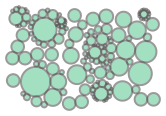

In [372]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.08
rcp.n_rads=80
rcp.run(10, progress_bar=True)
rcp.unfilled_circles

## lattice 1

100%|██████████| 10/10 [00:06<00:00,  1.66it/s]


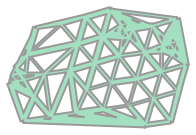

In [373]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.13,
    rad_seq_end=0.13, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 2.).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [374]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [375]:
stp = gp.ScaleTransPrms(d_buffer=-0.18,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [376]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [377]:
layer1 = gp.merge_LineStrings(fills)

In [378]:
all_polys = occluded_tris

## lattice 2

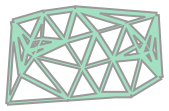

In [379]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [380]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [381]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [382]:
stp = gp.ScaleTransPrms(d_buffer=-0.28,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [383]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [384]:
layer2 = gp.merge_LineStrings(fills)

In [385]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [386]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(4)

In [387]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.8, 1.4).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [388]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [389]:
stp = gp.ScaleTransPrms(d_buffer=-0.38,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [390]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [391]:
layer3 = gp.merge_LineStrings(fills)

In [392]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [393]:

sk.stroke(4)
sk.geometry(layer1)
sk.stroke(5)
sk.geometry(layer2)
sk.stroke(6)
sk.geometry(layer3)
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-02-27T19:03:17.588624 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="265.2464,442.2047 248.605,436.0145 234.9991,431.2882 221.3267,426.8117 207.5927,422.5666 193.8044,418.5254 166.1029,410.9114 110.5054,396.4137 82.754,388.9874 37.7953,376.4453 37.7953,376.1198 82.8881,388.4839 110.6822,395.7501 166.3577,409.9548 194.0886,417.4584 207.8891,421.4537 221.6338,425.6589 235.3153,430.1013 248.9285,434.8001 268.7618,442.2047 269.4272,442.2047 249.015,434.4751 235.4231,429.6965 221.7654,425.1649 208.0459,420.8654 194.2709,416.7738 166.5903,409.0817 97.1199,390.8601 55.5752,379.411 37.7953,374.3489 37.7953,372.7755 83.66,385.5859 167.0072,407.5165 194.6836,415.2247 208.4565,419.3239 222.1746,423.6289 235.8316,428.163 249.4235,432.9416 262.9487,437.9708 273.7511,442.2047 276.9966,442.2047 263.2358,436.8931 249.6917,431.9347 236.0833,427.218 222.4129,422.734 208.6853,418.465 181.0872,410.4627 97.8464,388.1328 70.1735,380.4118 37.7953,371.0473 37.7953,369.9918 70.4319,379.4416 98.0978,387.189 167.463,405.8052 195.1283,413.555 222.6333,421.9066 236.3069,426.3787 249.9214,431.0726 263.4746,435.9964 279.6114,442.2047 281.4813,442.2047 263.6709,435.2594 250.1324,430.2805 236.5333,425.5285 222.8752,420.9984 209.1619,416.6757 195.3992,412.538 167.7587,404.6951 112.2935,389.7012 84.6089,382.0237 37.7953,368.4323 37.7953,367.7789 70.9043,377.6682 98.5308,385.5635 181.7417,408.0057 209.3479,415.9773 223.0801,420.2294 236.7552,424.6955 250.3689,429.3924 263.9194,434.3268 284.1717,442.2047 287.7197,442.2047 277.7633,438.1592 264.2886,432.9404 250.7481,427.9689 237.141,423.2471 223.4698,418.7661 209.7395,414.507 182.1331,406.5364 112.7682,387.9189 71.3008,376.1794 37.7953,366.1284 37.7953,364.5219 71.6774,374.7656 99.2632,382.8138 182.3338,405.7828 209.9158,413.8454 237.3281,422.5447 250.9581,427.1804 264.535,432.0157 291.4332,442.2047 264.5389,432.0008 250.9648,427.1553 232.7272,420.9989 209.9226,413.8199 182.3392,405.7625 99.3043,382.6595 71.7279,374.576 37.7953,364.3332"/>
 <polyline points="37.7953,341.5686 77.0566,354.5713 104.4853,363.2094 132.0357,371.3905 201.1125,391.0893 228.6204,399.4301 255.9677,408.3736 269.5751,413.0941 296.6688,422.9897 297.1695,423.1797 297.1427,423.4891 269.4293,413.6416 255.7882,409.0476 228.3744,400.3534 200.8027,392.2524 131.5882,373.0705 103.9954,365.0484 76.5338,356.534 37.7953,343.8102 37.7953,344.8406 62.5557,353.2052 89.9102,362.1217 103.6392,366.3857 131.2065,374.5034 200.442,393.6067 228.0444,401.5926 255.4831,410.193 269.1294,414.7673 297.0339,424.7435 297.1942,422.8949 269.6962,412.6395 242.5097,403.0924 228.8534,398.5555 201.4207,389.9326 118.6805,365.723 91.1907,357.3146 63.8045,348.517 37.7953,339.9465 37.7953,338.161 77.9357,351.2711 105.3854,359.8304 132.9387,368.0005 188.1496,383.9492 215.6506,392.3161 242.9965,401.2647 256.6039,405.9854 270.1695,410.8629 297.354,421.0521 297.6039,418.1698 270.907,408.0941 243.7276,398.5201 230.0635,394.0124 202.5927,385.5325 174.9757,377.6013 119.6432,362.109 92.0926,353.9287 78.3649,349.6599 50.9878,340.8281 37.7953,336.4993 37.7953,336.1518 78.4814,349.2225 105.9987,357.5278 133.6395,365.3695 189.0597,380.5328 216.6676,388.4978 230.4132,392.6998 257.7649,401.6268 271.3714,406.3504 297.7946,415.9709 297.8054,415.8461 284.9989,410.9955 257.8867,401.1693 230.5888,392.0403 203.1023,383.6195 175.4732,375.7336 120.1148,360.3384 92.5418,352.2423 78.7995,348.0284 37.7953,334.939 37.7953,333.2959 79.2103,346.4859 106.7342,354.7666 134.3742,362.6115 189.7899,377.7912 217.4011,385.7443 231.1495,389.9356 258.5068,398.8415 272.1146,403.5606 298.0503,413.0215 298.1912,411.3966 286.0933,406.8869 258.9127,397.3177 231.5309,388.5034 203.9721,380.3542 148.6054,364.99 120.97,357.1278 107.1945,353.0384 80.9369,344.868 107.2794,352.7199 121.1052,356.6203 148.8462,364.0861 204.4061,378.7247 232.0379,386.6003 245.7827,390.8047 259.4734,395.2126 273.1088,399.8282 298.4026,408.9593 298.431,408.6315 

In [394]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0284_cpack_beams.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

0

# Try 8

In [119]:
paper_size = '7x5 inches'
border:float=10
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

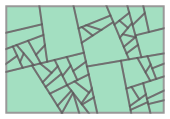

In [127]:
xgen = ss.uniform(loc=0.55, scale=0.1).rvs
split_func = functools.partial(gp.split_along_longest_side_of_min_rectangle, xgen=xgen)
splits = gp.recursive_split_frac_buffer(
    drawbox, 
    split_func=split_func,
    p_continue=0.8, 
    depth=0, 
    depth_limit=6,
    buffer_frac=-0.0
)

bps = MultiPolygon([p for p in splits])
bps

In [128]:
bg_bps_left = [bps]

In [129]:
bg_layers = []
for bg_bps in bg_bps_left:
    fills = []
    for p in bg_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.2, 1.)).rvs
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.4, 0.7),
            degrees=np.random.uniform(10, 140),
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=15,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    bg_layers.append(layer)

In [130]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(bg_layers):
    sk.stroke(i+1)
    sk.geometry(layer)

sk.penWidth('0.3')
for tolerance in [0.3, 0.6, 1.2]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-07T00:13:58.849623 
 
 
 
 
 
 
 
 
 <polyline points="319.202,442.2047 315.9652,428.7443 313.437,415.7628 306.8558,378.7266 307.3852,376.3235 304.0039,385.9977 298.604,399.574 292.7027,412.8979 279.0381,442.2047 279.5214,442.2047 292.8646,412.9794 298.6799,399.6122 303.9801,385.9857 307.6234,375.2427 308.1081,373.0426 312.7716,397.9691 316.6262,419.6693 319.1987,432.6429 321.4771,442.2047 323.5307,442.2047 320.078,428.0071 316.7167,410.6966 310.7167,375.9463 309.4332,367.0279 309.8256,365.247 305.3245,378.5152 302.7432,385.3631 299.9939,392.1264 294.0464,405.427 276.1046,442.2047 273.7187,442.2047 291.7317,404.2617 297.5724,390.9073 300.269,384.1175 305.1507,370.2803 313.7757,342.0329 317.0102,332.6371 316.8336,333.4386 317.3697,334.6518 322.6612,345.0852 325.0872,350.3407 327.1419,355.6618 328.383,359.857 328.6571,359.64 333.6451,367.0687 338.9665,402.23 341.2861,415.249 343.0949,423.8812 345.1524,432.4688 347.7874,442.2047 350.7702,442.2047 346.7567,427.703 343.8877,414.7826 341.5719,401.763 336.3627,368.1668 329.7643,358.7633 327.31,360.7065 330.82,365.9272 331.8983,366.3629 336.6163,398.1731 339.5112,415.5671 342.1689,428.5254 345.5795,442.2047 343.3461,442.2047 339.8368,428.9434 337.9103,420.3323 335.5006,407.3295 331.4391,381.1882 328.7131,365.0759 329.2003,365.2727 326.4646,361.3759 325.9107,361.8144 324.8214,356.0717 322.7861,348.8525 320.7281,343.532 316.5012,334.9474"/>
 <polyline points="317.9183,328.5154 318.6011,330.6449 320.1041,334.1688 326.5668,346.2899 329.0911,351.5281 331.0821,356.8604 331.2713,357.5701 331.0652,357.7333 339.4217,369.4028 338.8415,369.1684 342.5462,392.6319 344.9051,405.6437 347.6837,418.5804 350.9414,431.4312 353.9785,442.2047 356.4896,442.2047 352.3291,426.7042 348.3974,409.496 345.1546,392.1643 341.6367,370.013 337.6677,364.8752 332.0283,356.9708 333.6252,355.7064 340.9281,365.1227 344.2444,369.1717 344.4459,369.1066 345.1504,371.7177 345.6212,371.9079 350.9274,404.5642 353.4436,417.5479 355.3565,426.1615 359.4066,442.2047 361.8449,442.2047 357.532,425.7715 353.648,408.5548 350.3507,391.2329 347.1431,372.5229 347.9291,372.8405 346.6044,368.4102 346.2559,368.5226 345.2316,367.2712 335.1922,354.4657 335.7786,354.0015 335.2192,352.3402 333.6266,348.8322 331.6667,345.389 325.0889,335.1829 323.1185,331.7416 321.493,328.2394 320.8451,326.4591 319.9086,322.8352 319.599,320.8868 320.2215,318.0615 320.5801,320.8219 321.4842,324.4515 322.1371,326.2309 323.8331,329.7207 325.9567,333.1349 333.228,343.2185 335.408,346.6228 337.2097,350.0939 338.0256,352.2224 337.7666,352.4274 349.504,367.4746"/>
 
 <polyline points="359.3969,377.4742 360.9672,389.3298 362.3546,398.0376 364.9936,410.9993 368.3463,423.833 373.9381,442.2047 371.8104,442.2047 367.0158,424.0715 363.9576,411.185 361.3474,398.2182 359.845,389.531 357.9118,376.8741 358.3463,377.0497 356.1768,370.9679 354.7744,365.7741 354.4828,365.8681 342.7471,348.4841 343.4745,347.9081 342.5035,345.3694 341.6507,343.6253 339.6169,340.1952 333.709,331.7654 331.6609,328.3379 330.1633,324.8131 329.3421,321.1687 329.1457,317.4141 329.5184,309.7695 329.4813,307.5402 330.0231,307.8953 332.9971,275.559 334.5742,252.9164 330.8669,249.6039 329.1274,247.7238 327.6044,245.7661 326.3166,243.7238 325.2695,241.5951 324.453,239.3835 323.8408,237.0986 323.3917,234.755 322.0904,225.2028 321.5938,222.8763 320.9342,220.6084 319.2093,216.6085 319.6874,216.9593 321.2224,213.4344 327.0722,198.1184 329.7914,191.6682 332.8833,185.4181 337.5968,177.2898 339.3412,178.1554 334.699,186.3926 331.6954,192.6902 329.0576,199.184 324.1812,212.386 321.66,218.4069 320.2533,217.3746 321.5721,220.3792 322.2953,222.6243 322.8624,224.9255 324.4603,234.3711 324.9795,236.6895 325.6599,238.95 326.5437,241.1373 327.6592,243.2415 329.019,245.2579 330.62,247.1876 332.4461,249.0365 334.9542,251.1918 332.7524,248.9265 329.6413,245.0343 328.3805,242.9824 327.3236,240.8572 325.765,236.4073 323.2233,224.7958 321.6933,220.3357 320.1

In [131]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.6,
    rad_seq_end=0.08,
    min_allowed_rad=3,
    n_rads=10,
)
rcp.run(1)

100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

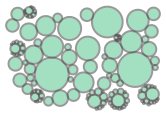

In [132]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.08
rcp.n_rads=80
rcp.run(10, progress_bar=True)
rcp.unfilled_circles

## lattice 1

100%|██████████| 10/10 [00:04<00:00,  2.05it/s]


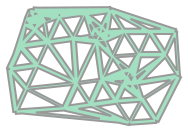

In [133]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.13,
    rad_seq_end=0.13, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 2.).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [134]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [135]:
stp = gp.ScaleTransPrms(d_buffer=-0.14,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [136]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [137]:
layer1 = gp.merge_LineStrings(fills)

In [138]:
all_polys = occluded_tris

## lattice 2

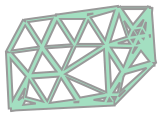

In [139]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [140]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [141]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [142]:
stp = gp.ScaleTransPrms(d_buffer=-0.28,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [143]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [144]:
layer2 = gp.merge_LineStrings(fills)

In [145]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [146]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(4)

In [147]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.8, 1.4).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [148]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [149]:
stp = gp.ScaleTransPrms(d_buffer=-0.38,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [150]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [151]:
layer3 = gp.merge_LineStrings(fills)

In [152]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [153]:
bg_layer = gp.robust_difference(bg_layers[0], all_polys)

ERROR:shapely.geos:TopologyException: Input geom 1 is invalid: Self-intersection at or near point 26.311331344575379 58.685429336993074 at 26.311331344575379 58.685429336993074


In [154]:
bg_layer

In [156]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
sk.stroke(1)
sk.geometry(bg_layer)
sk.stroke(4)
sk.geometry(layer1)
sk.stroke(5)
sk.geometry(layer2)
sk.stroke(6)
sk.geometry(layer3)
sk.penWidth('0.3')
for tolerance in [0.1, 0.2, 0.3]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-07T00:15:15.425946 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="516.6596,38.5019 514.3425,37.7953 519.2509,39.1088 530.0247,40.9998 537.7982,42.8207 540.2649,43.591 545.0066,45.383 549.5187,47.4764 553.6634,49.7039 547.6565,45.9129 541.1401,42.4425 538.8463,41.4453 534.0538,39.7198 527.1623,37.7953 531.566,38.9772 536.4836,40.5386 541.1401,42.4425 545.5369,44.6872 562.8702,55.2561 566.4347,57.0254 564.4377,55.9493 560.3457,53.3047 555.4553,49.5304 550.325,46.4185 546.0081,44.0689 541.4905,41.9827 536.728,40.218 527.7276,37.7953 534.2532,39.4582 541.4905,41.9827 548.1877,45.2159 555.4552,49.5304 548.8517,44.3446 544.7856,41.666 540.3938,39.4147 536.0402,37.7953 538.0567,38.4743 542.6354,40.4804 546.8535,42.9596 550.7958,45.8006 555.4553,49.5304 564.9269,55.3074 572.951,59.7232 577.62,61.2804 573.6409,59.9904 577.5561,61.5467 573.0679,59.7874 577.3603,62.3631 573.0679,59.7874 568.8534,58.1692 562.8703,55.2561 574.0567,62.371 568.4423,58.7086 553.6635,49.704 547.2887,46.3955 542.6668,44.4462 537.7982,42.8207 532.6728,41.532 521.9182,39.6158"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="346.3431,60.1634 345.8965,56.2901 345.8412,54.2462 346.1813,50.1194 346.612,48.0334 348.0503,43.8114 349.0527,41.6759 351.2467,37.7953 349.0527,41.6759 348.0503,43.8114 346.6121,48.0334 346.1813,50.1194 345.8412,54.2462 345.8965,56.2901 346.3431,60.1633 346.8131,56.2107 347.3679,54.114 348.6207,50.971 349.501,47.7832 351.4764,43.5147 355.1992,37.7953 352.7701,41.354 350.3795,45.6584 349.501,47.7832 348.6207,50.971 351.1024,45.5958 352.2884,43.4444 355.1153,39.1022 356.0413,37.7953 352.2885,43.4444 351.1024,45.5958 349.6098,49.025 351.7723,45.5378 353.3768,43.3502 357.9489,37.7953 355.1286,41.1498 351.7723,45.5378 349.6098,49.0251 348.6828,51.9514 348.156,54.8377 348.2272,58.137 348.8144,62.1835 349.8978,66.5966 349.6405,64.1607 349.736,60.055 350.495,55.8919 351.1379,53.7875 351.9631,51.6674 354.1613,47.3796 357.0254,43.0342 360.9915,37.7953 355.5196,45.2133 352.9721,49.5313 351.1379,53.7875 350.0297,57.9809 349.608,62.1148 349.8978,66.5967 351.7175,72.1756 353.6751,77.275 351.837,73.6356 353.896,78.1565 350.2878,70.2507 348.9636,66.268 348.4969,64.2597 347.9636,60.2085 347.9065,58.1648 348.1766,54.044 348.6207,50.9711 347.368,54.114 346.8131,56.2107 346.4703,58.2891 346.3695,60.3466 347.2395,64.3686 348.4525,68.361 349.9891,72.3253 352.4932,77.6406 349.9891,72.3253 348.4525,68.361 347.2395,64.3686 346.3431,60.1634 346.3843,62.394 346.6228,64.422 347.6208,68.433 349.2543,72.3889 352.1708,77.5057 349.2543,72.3889 347.6208,68.433 346.6228,64.422 346.3843,62.394"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="320.1733,217.3159 321.6933,220.3357 323.2233,224.7958 325.765,236.4073 327.3236,240.8572 328.3805,242.9824 329.6413,245.0343 331.1033,247.014 333.5356,249.7257 331.1033,247.014 329.6413,245.0343 328.3805,242.9824 327.3236,240.8572 325.765,236.4073 323.2233,224.7958 321.6933,220.3357 320.6318,218.1173 321.5721,220.3792 322.8624,224.9255 324.4603,234.3711 325.6599,238.95 326.5437,241.1373 327.6592,243.2415 329.019,245.2579 330.4534,246.9868 329.019,245.2579 327.6592,243.2415 326.5437,241.1373 325.6599,238.95 324.9795,236.6895 324.4603,234.3711 322.8624,224.9255 322.2953,222.6243 321.5721,220.3792"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 


In [157]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0287_cpack_beams.svg'

sk.save(savepath)


# Try 9

In [2]:
paper_size = '7x5 inches'
border:float=10
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

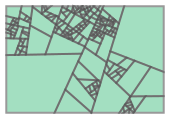

In [3]:
xgen = ss.uniform(loc=0.3, scale=0.25).rvs
split_func = functools.partial(gp.split_along_longest_side_of_min_rectangle, xgen=xgen)
splits = gp.recursive_split_frac_buffer(
    drawbox, 
    split_func=split_func,
    p_continue=0.8, 
    depth=0, 
    depth_limit=9,
    buffer_frac=-0.0
)

bps = MultiPolygon([p for p in splits])
bps

In [4]:
bg_bps_left = [bps]

In [5]:
bg_layers = []
for bg_bps in bg_bps_left:
    fills = []
    for p in bg_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.2, 1.)).rvs
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.12, 0.6),
            degrees=np.random.uniform(10, 140),
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=15,
            n_eval_points=30,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    bg_layers.append(layer)

In [6]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(bg_layers):
    sk.stroke(i+1)
    sk.geometry(layer)

sk.penWidth('0.3')
# for tolerance in [0.3, 0.6, 1.2]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm')
# sk.vpype('linesimplify --tolerance 0.1 linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-09T14:55:46.904394 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline point

In [7]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.6,
    rad_seq_end=0.08,
    min_allowed_rad=3,
    n_rads=10,
)
rcp.run(1)

100%|██████████| 10/10 [00:05<00:00,  2.14it/s]

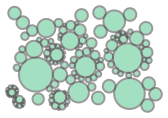

In [8]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.08
rcp.n_rads=80
rcp.run(10, progress_bar=True)
rcp.unfilled_circles

## lattice 1

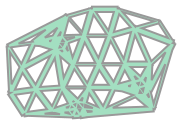

In [9]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.13,
    rad_seq_end=0.13, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 2.).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [10]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [11]:
stp = gp.ScaleTransPrms(d_buffer=-0.19,angles=-45,)
stp.d_buffers += np.random.uniform(-0.06, 0.12, size=stp.d_buffers.shape)

In [12]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [13]:
layer1 = gp.merge_LineStrings(fills)

In [14]:
all_polys = occluded_tris

## lattice 2

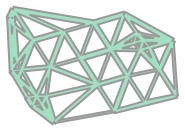

In [15]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [16]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [17]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [18]:
stp = gp.ScaleTransPrms(d_buffer=-0.28,angles=-45,)
stp.d_buffers += np.random.uniform(-0.08, 0.08, size=stp.d_buffers.shape)

In [19]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [20]:
layer2 = gp.merge_LineStrings(fills)

100%|██████████| 10/10 [00:07<00:00,  1.29it/s]


In [21]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [22]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(1)

In [23]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.4, 0.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [24]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [25]:
stp = gp.ScaleTransPrms(d_buffer=-0.38,angles=-45,)
stp.d_buffers += np.random.uniform(-0.09, 0.09, size=stp.d_buffers.shape)

In [26]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [27]:
layer3 = gp.merge_LineStrings(fills)

In [28]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [29]:
bg_layer = gp.robust_difference(bg_layers[0], all_polys)

ERROR:shapely.geos:TopologyException: Input geom 1 is invalid: Self-intersection at or near point 23.820368944904388 59.139830667077646 at 23.820368944904388 59.139830667077646
ERROR:shapely.geos:TopologyException: Input geom 1 is invalid: Self-intersection at or near point 41.234878486327922 43.188262189026489 at 41.234878486327922 43.188262189026489


TopologicalError: The operation 'GEOSDifference_r' could not be performed. Likely cause is invalidity of the geometry <shapely.geometry.multipolygon.MultiPolygon object at 0x7f80365f7820>

In [214]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
sk.stroke(1)
sk.geometry(bg_layer)
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(1)
sk.geometry(layer2)
sk.stroke(1)
sk.geometry(layer3)
sk.penWidth('0.3')
sk.vpype('splitall')
# for tolerance in [0.2,]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm linesimplify --tolerance 0.1')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-09T00:46:21.988150 
 
 
 
 
 
 
 
 
 <polyline points="629.1368,231.1397 629.3205,232.0141 629.7845,232.772 630.2623,234.7819 630.353,236.2798 630.3034,234.7223 629.894,232.6132 629.1368,231.1397 628.6304,231.1464 629.3973,233.3338 629.5631,234.6764 629.5509,233.111 629.3205,232.0141 628.6304,231.1464 629.3205,232.0141 629.1368,231.1397 628.3513,230.408 628.6304,231.1464 628.2165,230.9854 628.6838,231.6661 628.833,232.1757 628.7398,231.5848 628.0469,230.7382 628.7935,231.7276 628.6304,231.1464 627.9285,230.6554 628.2164,230.9853 627.9285,230.6554"/>
 
 
 <polyline points="625.773,228.3096 626.7295,228.2447 627.1106,228.5425 628.1162,229.7864 628.3513,230.408 627.9381,230.0449 626.8112,229.5623 625.7636,228.2994 626.7295,228.2447 625.4756,228.3297 625.773,228.3096 624.9759,227.5586 625.8059,227.56 626.6764,228.2031 625.7636,228.2994 626.037,227.7033 626.7875,228.1914 625.8455,227.5601 627.69,227.7018 628.9867,228.0872 626.7875,228.1914 625.6258,227.4143 627.8192,227.5143 629.4327,227.8762 630.0117,228.2309 627.69,227.7018 625.8059,227.56 625.6258,227.4143 625.8455,227.56 624.9759,227.5586 624.8084,227.4096 625.5486,227.4138 625.8059,227.56 625.5755,227.381 627.9641,227.3041 629.7148,227.4669 631.1627,228.0692 632.1868,229.2864 632.2798,229.6141 632.1489,229.3413 630.9196,228.422 630.0118,228.2309 629.4327,227.8762 627.8192,227.5143 625.5486,227.4138 624.4741,226.7993 624.6969,226.7983 625.5755,227.381 624.8072,227.4085 624.1021,226.78 624.474,226.7993 625.4961,227.384 624.9759,227.5586 623.7139,227.5521 623.5863,227.4096 624.8084,227.4096 624.9759,227.5586 624.8324,227.4087 623.5863,227.4096 624.8084,227.4095 623.5573,227.3771 622.97,226.7213 624.1021,226.78 624.8072,227.4085 624.6969,226.7983 624.474,226.7993 623.3404,226.0995 622.2771,225.064 624.6969,226.7983 624.1021,226.78 623.3405,226.0996 624.474,226.7993 622.97,226.7213 621.2604,224.7562 621.7104,224.9048 624.1021,226.78"/>
 <polyline points="622.7092,227.5377 624.4273,228.357 623.7139,227.5521 622.7092,227.5377 622.346,227.3554 622.7092,227.5377 623.7139,227.5521 623.5863,227.4096 622.2782,227.3131 623.5573,227.3771 622.2782,227.3131 623.5573,227.3771 622.97,226.7213 620.6446,226.1097 621.0448,226.5315 622.2782,227.3131 621.6451,227.4755 622.318,228.4186 624.4631,228.3975 622.7092,227.5377 621.6451,227.4755 621.7281,227.235 622.3459,227.3554 621.4458,227.195 621.6451,227.4754 622.7092,227.5377 621.4458,227.195 622.2782,227.3131 620.864,226.3931 621.4331,227.1771 620.8366,227.3977 621.6169,228.1979 622.318,228.4186 621.6451,227.4755 620.8366,227.3977 620.4291,227.0185 620.8366,227.3977 621.645,227.4754 621.4458,227.195 620.4291,227.0185 620.2011,226.8338 620.6639,227.084 621.4331,227.1771 620.2011,226.8338 619.6763,227.1782 621.6169,228.1979 620.8366,227.3977 619.2251,227.0737 620.0755,228.0449 621.8263,228.4323 619.6763,227.1782 619.2251,227.0737 618.7562,226.5026 619.6763,227.1782 620.8366,227.3977 620.4291,227.0185 618.4995,226.3946 619.2251,227.0737 619.6763,227.1782 618.7561,226.5026 618.5463,226.8631 619.1297,227.5392 620.0754,228.0449 619.2251,227.0737 618.5463,226.8631"/>
 
 <polyline points="621.6169,228.1979 622.318,228.4186 621.8263,228.4323 621.6169,228.1979 621.8263,228.4323 622.3355,228.443 621.8263,228.4323 622.3585,228.4751 622.5857,228.7924 622.0239,228.6657 621.8518,228.4624 622.0239,228.6657 622.5857,228.7924 623.1904,229.642 622.8014,229.5981 622.0239,228.6657 622.318,228.4186 625.0437,229.0743 625.2558,229.3629 622.5857,228.7924 622.3585,228.4751 624.4631,228.3975 622.4078,228.4445 624.4776,228.4139 625.0436,229.0742 622.5283,228.4794 622.5857,228.7924 625.2558,229.3629 625.6865,229.9489 623.1904,229.642 622.5857,228.7924"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="625.8736,204.0847 623.3901,208.2988 625.8736,204.0847 625.5015,203.87 625.7057,204.1229 624.5483,202.6723 622.8141,200.2296 621.6048,197.6426 621.0409,194.8782 620.6022,189.1601 619.2372,182.4813 620.60

In [213]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0293_cpack_beams.svg'

sk.save(savepath)


# Try 10

In [224]:
paper_size = '7x5 inches'
border:float=10
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

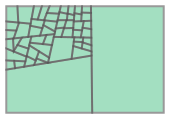

In [225]:
xgen = ss.uniform(loc=0.35, scale=0.25).rvs
split_func = functools.partial(gp.split_along_longest_side_of_min_rectangle, xgen=xgen)
splits = gp.recursive_split_frac_buffer(
    drawbox, 
    split_func=split_func,
    p_continue=0.8, 
    depth=0, 
    depth_limit=7,
    buffer_frac=-0.0
)

bps = MultiPolygon([p for p in splits])
bps


In [226]:
bg_bps_left = [bps]

In [239]:
bg_layers = []
for bg_bps in bg_bps_left:
    fills = []
    for p in bg_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.15, 0.8)).rvs
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.3, 0.45),
            degrees=np.random.uniform(10, 170),
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.2,
            n_nodes_per_line=15,
            n_eval_points=40,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    bg_layers.append(layer)

In [240]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(bg_layers):
    sk.stroke(i+1)
    sk.geometry(layer)

sk.penWidth('0.3')
# for tolerance in [0.3, 0.6, 1.2]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm')
# sk.vpype('linesimplify --tolerance 0.1 linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-12T00:08:02.506498 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="362.4131,108.7676 362.6312,109.0714 371.9446,121.1681 381.6305,132.8682 391.6715,144.1899 402.0292,155.1745 412.6526,165.876 423.4845,176.3553 434.4652,186.6762 445.5352,196.902 456.6363,207.0946 467.7131,217.3132 478.7138,227.6128 489.5917,238.0431 500.3083,248.6453 510.8372,259.4475 521.1697,270.4588 531.3216,281.6625 541.3396,293.0087 551.3067,304.4093 561.3434,315.7356 571.6046,326.823 582.2671,337.4828 593.5093,347.5251 605.4793,356.7923 618.2527,365.2037 631.7827,372.8092 634.2047,374.0219"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="362.6715,86.2679 362.9657,86.6982 371.8843,99.2155 381.1746,111.337 390.9251,122.9682 401.1584,134.0851 411.844,144.7204 422.9126,154.9476 434.2713,164.8659 445.8163,174.5858 457.4437,184.2178 469.0577,193.8642 480.5757,203.6128 491.9315,213.5342 503.0767,223.6798 513.9825,234.0805 524.6403,244.7453 535.0646,255.6589 545.2956,266.7782 555.4029,278.0295 565.487,289.3054 575.6792,300.4661 586.1359,311.3452 597.0257,321.7629 608.508,331.5494 620.7017,340.5783 633.6437,348.8102 634.2047,349.1211"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="362.9545,61.6318 364.1559,63.4137 372.7474,76.2794 381.5996,88.8675 390.9222,100.9544 400.8281,112.4202 411.3448,123.2353 422.4318,133.4429 433.9989,143.1392 445.9238,152.4544 458.0682,161.5358 470.2913,170.5333 482.4606,179.5883 494.4591,188.8251 506.1915,198.3453 517.5876,208.2237 528.6048,218.5058 539.2308,229.2045 549.4858,240.2983 559.4253,251.7283 569.1417,263.3957 578.7657,275.1618 588.463,286.8496 598.428,298.2524 608.8686,309.1486 619.9839,319.326 631.9315,328.6171 634.2047,330.0897"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="342.1638,251.8397 340.4607,251.11 329.4474,246.0484 318.497,240.7896 307.6118,235.3261 296.8094,229.6029 286.1088,223.5601 275.5229,217.1577 265.0542,210.3879 254.6938,203.2779 244.4232,195.8863 234.2158,188.2965 224.0399,180.608 213.8614,172.9275 203.6463,165.3619 193.3621,158.0129 182.9794,150.973 172.4721,144.3241 161.8178,138.1362 150.9987,132.4655 140.0021,127.3515 128.8227,122.811 117.465,118.83 105.9461,115.3543 94.2984,112.2832 82.5682,109.4706 70.8108,106.7434 59.0756,103.9464 47.3801,101.0253 37.7953,98.6792"/>
 <polyline points="37.7953,98.3249 47.5523,100.4849 59.3002,103.242 71.0661,105.9426 82.8396,108.6192 94.5767,111.4099 106.2259,114.4766 117.7425,117.9593 129.095,121.9568 140.266,126.5235 151.2508,131.6744 1

In [274]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.55,
    rad_seq_end=0.09,
    min_allowed_rad=10,
    n_rads=20,
)
rcp.run(1)


100%|██████████| 4/4 [00:02<00:00,  1.43it/s]

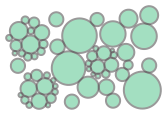

In [275]:
rcp.rad_seq_start=0.4
rcp.rad_seq_end=0.1
rcp.n_rads=80
rcp.run(4, progress_bar=True)
rcp.unfilled_circles

## lattice 1

100%|██████████| 4/4 [00:06<00:00,  1.72s/it]


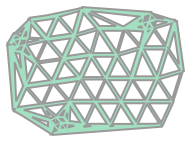

In [276]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.13,
    rad_seq_end=0.13, min_allowed_rad=4, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.8, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [277]:
occluded_tris = tris.intersection(rcp.unfilled_circles)

In [278]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [279]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [280]:
layer1 = gp.merge_LineStrings(fills)

In [281]:
all_polys = occluded_tris

## lattice 2

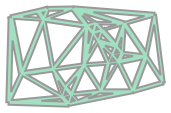

In [282]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [283]:
int_tris = tris.intersection(rcp.unfilled_circles).buffer(0.5)

In [284]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [285]:
stp = gp.ScaleTransPrms(d_buffer=-0.3,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [286]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [287]:
layer2 = gp.merge_LineStrings(fills)

In [288]:
all_polys = so.unary_union([all_polys, occluded_tris])

## lattice3

In [289]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(1)

In [290]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.4, 1.2).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [291]:
int_tris = tris.intersection(rcp.unfilled_circles).buffer(2.3)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

ERROR:shapely.geos:TopologyException: found non-noded intersection between LINESTRING (130.72 49.621, 124.116 49.621) and LINESTRING (130.153 49.621, 130.473 48.965) at 130.15266065488936 49.620961830981159


In [292]:
stp = gp.ScaleTransPrms(d_buffer=-0.38,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [293]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [294]:
layer3 = gp.merge_LineStrings(fills)

In [295]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [296]:
mbg = gp.merge_LineStrings([l for l in bg_layers[0] if l.length>0.05])

In [297]:
bg_layer = gp.robust_difference(mbg, all_polys.buffer(1e-6))

In [301]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
sk.stroke(1)
sk.geometry(bg_layer)
for tolerance in [0.1, 0.2, 0.4, 0.8]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-12T00:12:21.368008 
 
 
 
 
 
 <polyline points="358.6533,436.1383 362.2527,439.7269 364.7247,442.2047 365.127,442.2047 362.4606,439.5054 358.6588,435.6566 358.6601,435.5396 362.5283,439.4333 365.2961,442.2047 367.2201,442.2047 363.447,438.4548 358.6814,433.6883 358.6677,434.8832 358.6524,434.8292 358.393,433.3979 358.2005,431.92 358.0271,430.4289 357.8332,428.9521 357.5878,427.5111 357.2681,426.1217 356.8581,424.7951 356.3476,423.5383 355.7321,422.3546 355.012,421.2436 354.193,420.2014 353.2858,419.2205 352.3057,418.2903 351.2715,417.3978 351.1267,417.2799 349.9745,417.3134 350.2705,417.13 351.5967,416.358 352.9438,415.6308 354.3158,414.957 355.7181,414.3482 357.1581,413.8202 358.6442,413.3913 358.9151,413.3365 358.9132,413.5062 362.7986,417.1286 373.898,427.323 385.0573,437.4537 390.3285,442.2047 390.798,442.2047 385.2402,437.2589 374.0415,427.1702 362.9323,416.9862 358.9164,413.2272 358.9251,412.4671 363.3308,416.5617 374.4952,426.687 385.7616,436.7036 392.0332,442.2047 393.2599,442.2047 386.3133,436.1159 375.0489,426.0972 363.8921,415.9638 358.938,411.3477 358.9387,411.2863 357.7421,411.4559 356.2282,411.8253 354.7734,412.3213 353.3677,412.9229 352.0018,413.6098 350.6674,414.3642 349.3575,415.1713 348.0664,416.0187 346.789,416.8954 346.0348,417.4281 346.0275,417.4283 346.2705,417.6515 347.2612,418.5744 348.228,419.5138 349.1527,420.4826 350.0165,421.4936 350.8034,422.5582 351.5016,423.6844 352.1053,424.8763 352.6158,426.1331 353.0409,427.4492 353.3954,428.8144 353.7002,430.2141 353.9822,431.6296 354.2735,433.0388 354.6109,434.4159 355.0344,435.733 355.5852,436.9618 356.3008,438.0759 357.2078,439.0569 358.312,439.9009 358.6081,440.0704 358.6112,439.801 360.4517,441.6453 361.0093,442.2047 359.1102,442.2047 358.5896,441.6842 358.5895,441.6897 358.2292,441.5701 356.7958,440.9551 355.5728,440.1937 354.5821,439.2709 353.8101,438.196 353.223,436.9925 352.7773,435.6907 352.4269,434.3227 352.1276,432.9192 351.8393,431.5079 351.5277,430.1129 351.1645,428.7538 350.728,427.4456 350.2037,426.1985 349.5841,425.0176 348.8695,423.9028 348.067,422.8491 347.1902,421.8471 346.257,420.8843 345.2877,419.9465 344.3021,419.0202 343.3165,418.0938 342.7222,417.5245"/>
 
 
 <polyline points="388.0373,442.2047 384.008,438.5713 372.863,428.4255 361.7914,418.2014 358.8906,415.4747 358.8843,416.0193 358.2591,416.1825 356.7934,416.6553 355.4673,417.1536 354.3418,417.1864 355.1078,417.9538 355.9674,418.9677 356.7276,420.0508 357.3839,421.2062 357.9371,422.4332 358.3923,423.7284 358.7591,425.0851 358.7791,425.1818 358.7777,425.3018 367.6624,433.9648 376.2463,442.2047 376.3717,442.2047 367.7542,433.8671 358.7799,425.1146 358.762,426.6659 367.0483,434.6189 375.0122,442.2047 374.8739,442.2047 366.9841,434.6873 358.7605,426.8032 358.7429,428.3374 366.2039,435.5184 373.1836,442.2047"/>
 
 
 <polyline points="323.3443,414.6808 323.1061,414.6822 321.7161,414.5664 320.2784,414.3154 318.8012,413.9522 317.301,413.5235 315.7988,413.089 314.3169,412.7122 314.068,412.6675 314.0325,412.6735 314.4154,411.3716 314.6987,409.9645 314.7891,408.6115 314.6505,407.3225 314.2655,406.1026 313.6366,404.9509 312.7842,403.8618 311.7442,402.8253 310.5634,401.8282 309.2945,400.8557 307.9906,399.893 306.7,398.9266 305.4612,397.9457 304.2994,396.9433 303.224,395.9167 302.2286,394.8676 301.2929,393.8019 300.3872,392.7277 299.4787,391.6543 298.5399,390.5894 297.5582,389.5366 296.544,388.4928 295.5379,387.4467 295.4571,387.3534 296.6227,386.819 296.8714,387.0734 297.9271,388.1055 298.9765,389.1394 300.0023,390.18 301.0093,391.2258 302.019,392.2708 303.0617,393.3066 304.1691,394.3243 305.3672,395.3166 306.6703,396.2795 308.0774,397.2133 309.5707,398.1229 311.1161,399.0179 312.6652,399.9119 313.4019,400.3603 313.4019,400.3603 314.1594,400.8213 315.5349,401.7639 316.7278,402.7577 317.6805,403.8187 318.3471,404.9598 318.6983,406.1892 318.7257,407.5093 318.4446,408.9157 317.8947,410.3974 317.2321,411.7459 317.2321,411.7

In [302]:
sk.stroke(2)
sk.geometry(layer1)
sk.stroke(3)
sk.geometry(layer2)
sk.stroke(4)
sk.geometry(layer3)
sk.penWidth('0.3')

# tolerance=0.1
# sk.vpype(f'linesimplify --tolerance {tolerance}')
# for tolerance in [0.1, 0.2, 0.4]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-12T00:12:49.989718 
 
 
 
 
 
 <polyline points="358.6533,436.1383 362.2527,439.7269 364.7247,442.2047 365.127,442.2047 362.4606,439.5054 358.6588,435.6566 358.6601,435.5396 362.5283,439.4333 365.2961,442.2047 367.2201,442.2047 363.447,438.4548 358.6814,433.6883 358.6677,434.8832 358.6524,434.8292 358.393,433.3979 358.2005,431.92 358.0271,430.4289 357.8332,428.9521 357.5878,427.5111 357.2681,426.1217 356.8581,424.7951 356.3476,423.5383 355.7321,422.3546 355.012,421.2436 354.193,420.2014 353.2858,419.2205 352.3057,418.2903 351.2715,417.3978 351.1267,417.2799 349.9745,417.3134 350.2705,417.13 351.5967,416.358 352.9438,415.6308 354.3158,414.957 355.7181,414.3482 357.1581,413.8202 358.6442,413.3913 358.9151,413.3365 358.9132,413.5062 362.7986,417.1286 373.898,427.323 385.0573,437.4537 390.3285,442.2047 390.798,442.2047 385.2402,437.2589 374.0415,427.1702 362.9323,416.9862 358.9164,413.2272 358.9251,412.4671 363.3308,416.5617 374.4952,426.687 385.7616,436.7036 392.0332,442.2047 393.2599,442.2047 386.3133,436.1159 375.0489,426.0972 363.8921,415.9638 358.938,411.3477 358.9387,411.2863 357.7421,411.4559 356.2282,411.8253 354.7734,412.3213 353.3677,412.9229 352.0018,413.6098 350.6674,414.3642 349.3575,415.1713 348.0664,416.0187 346.789,416.8954 346.0348,417.4281 346.0275,417.4283 346.2705,417.6515 347.2612,418.5744 348.228,419.5138 349.1527,420.4826 350.0165,421.4936 350.8034,422.5582 351.5016,423.6844 352.1053,424.8763 352.6158,426.1331 353.0409,427.4492 353.3954,428.8144 353.7002,430.2141 353.9822,431.6296 354.2735,433.0388 354.6109,434.4159 355.0344,435.733 355.5852,436.9618 356.3008,438.0759 357.2078,439.0569 358.312,439.9009 358.6081,440.0704 358.6112,439.801 360.4517,441.6453 361.0093,442.2047 359.1102,442.2047 358.5896,441.6842 358.5895,441.6897 358.2292,441.5701 356.7958,440.9551 355.5728,440.1937 354.5821,439.2709 353.8101,438.196 353.223,436.9925 352.7773,435.6907 352.4269,434.3227 352.1276,432.9192 351.8393,431.5079 351.5277,430.1129 351.1645,428.7538 350.728,427.4456 350.2037,426.1985 349.5841,425.0176 348.8695,423.9028 348.067,422.8491 347.1902,421.8471 346.257,420.8843 345.2877,419.9465 344.3021,419.0202 343.3165,418.0938 342.7222,417.5245"/>
 
 
 <polyline points="388.0373,442.2047 384.008,438.5713 372.863,428.4255 361.7914,418.2014 358.8906,415.4747 358.8843,416.0193 358.2591,416.1825 356.7934,416.6553 355.4673,417.1536 354.3418,417.1864 355.1078,417.9538 355.9674,418.9677 356.7276,420.0508 357.3839,421.2062 357.9371,422.4332 358.3923,423.7284 358.7591,425.0851 358.7791,425.1818 358.7777,425.3018 367.6624,433.9648 376.2463,442.2047 376.3717,442.2047 367.7542,433.8671 358.7799,425.1146 358.762,426.6659 367.0483,434.6189 375.0122,442.2047 374.8739,442.2047 366.9841,434.6873 358.7605,426.8032 358.7429,428.3374 366.2039,435.5184 373.1836,442.2047"/>
 
 
 <polyline points="323.3443,414.6808 323.1061,414.6822 321.7161,414.5664 320.2784,414.3154 318.8012,413.9522 317.301,413.5235 315.7988,413.089 314.3169,412.7122 314.068,412.6675 314.0325,412.6735 314.4154,411.3716 314.6987,409.9645 314.7891,408.6115 314.6505,407.3225 314.2655,406.1026 313.6366,404.9509 312.7842,403.8618 311.7442,402.8253 310.5634,401.8282 309.2945,400.8557 307.9906,399.893 306.7,398.9266 305.4612,397.9457 304.2994,396.9433 303.224,395.9167 302.2286,394.8676 301.2929,393.8019 300.3872,392.7277 299.4787,391.6543 298.5399,390.5894 297.5582,389.5366 296.544,388.4928 295.5379,387.4467 295.4571,387.3534 296.6227,386.819 296.8714,387.0734 297.9271,388.1055 298.9765,389.1394 300.0023,390.18 301.0093,391.2258 302.019,392.2708 303.0617,393.3066 304.1691,394.3243 305.3672,395.3166 306.6703,396.2795 308.0774,397.2133 309.5707,398.1229 311.1161,399.0179 312.6652,399.9119 313.4019,400.3603 313.4019,400.3603 314.1594,400.8213 315.5349,401.7639 316.7278,402.7577 317.6805,403.8187 318.3471,404.9598 318.6983,406.1892 318.7257,407.5093 318.4446,408.9157 317.8947,410.3974 317.2321,411.7459 317.2321,411.7

In [303]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0301_cpack_beams.svg'

sk.save(savepath)


# Try 11

In [63]:
paper_size = '7x5 inches'
border:float=10
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

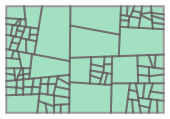

In [64]:
xgen = ss.uniform(loc=0.35, scale=0.25).rvs
split_func = functools.partial(gp.split_along_longest_side_of_min_rectangle, xgen=xgen)
splits = gp.recursive_split_frac_buffer(
    drawbox, 
    split_func=split_func,
    p_continue=0.8, 
    depth=0, 
    depth_limit=7,
    buffer_frac=-0.0
)

bps = MultiPolygon([p for p in splits])
bps


In [65]:
bg_bps_left = [bps]

In [66]:
bg_layers = []
for bg_bps in bg_bps_left:
    fills = []
    for p in bg_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.15, 0.8)).rvs
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.3, 0.45),
            degrees=np.random.uniform(10, 170),
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.2,
            n_nodes_per_line=15,
            n_eval_points=40,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    bg_layers.append(layer)

In [67]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(bg_layers):
    sk.stroke(i+1)
    sk.geometry(layer)

sk.penWidth('0.3')
# for tolerance in [0.3, 0.6, 1.2]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm')
# sk.vpype('linesimplify --tolerance 0.1 linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-25T13:41:11.778784 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="624.9287,258.2672 622.8237,258.8396 616.8929,260.6877 610.9842,262.6315 605.0745,264.571 599.1481,266.4381 593.1965,268.1962 587.2174,269.8356 581.213,271.3654 575.1879,272.806 569.1478,274.1815 563.0979,275.5143 557.042,276.8218 550.9829,278.1149 544.9215,279.3984 538.858,280.6725 532.7916,281.9343 526.7216,283.1804 520.6473,284.4081 514.5686,285.6166 508.4859,286.8081 502.4007,287.9883 496.315,289.1668 490.2322,290.3574 484.1565,291.5792 478.0937,292.8563 472.0501,294.2169 466.0328,295.691 465.7703,295.7618"/>
 <polyline points="465.8362,297.2257 466.3552,297.085 472.3679,295.5912 478.4049,294.2024 484.46,292.8916 490.5272,291.6333 496.6015,290.4059 502.6791,289.1925 508.7571,287.9807 514.8334,286.7618 520.9069,285.5307 526.977,284.2852 533.044,283.0257 539.1081,281.7543 545.1701,280.4734 551.2303,279.1847 557.2883,277.8866 563.3426,276.5727 569.3904,275.2305 575.4273,273.8413 581.448,272.3816 587.4465,270.8266 593.4184,269.1561 599.3618,267.3621 605.2793,265.4566 611.1802,263.4793 617.0813,261.5027 623.0068,259.6317 627.648,258.3628"/>
 <polyline points="634.2047,258.8114 629.414,259.8437 623.4304,261.4634 617.494,263.2872 611.5795,265.2057 605.6652,267.1254 599.7355,268.9781 593.781,270.7238 587.7984,272.348 581.789,273.8563 575.7572,275.2678 569.7089,276.6079 563.6503,277.9033 557.5867,279.1771 551.5223,280.4475 545.4598,281.726 539.4004,283.018 533.3441,284.3237 527.2901,285.6392 521.2369,286.9578 515.1824,288.2713 509.1249,289.5712 503.0625,290.8505 496.9945,292.1052 490.921,293.3362 484.8439,294.5517 478.7672,295.769 472.6972,297.0152 466.6423,298.3264 465.8937,298.5024"/>
 <polyline points="465.9652,300.0882 466.9939,299.8472 473.0517,298.5483 479.1262,297.3216 485.2085,296.1284 491.2917,294.9393 497.3715,293.7355 503.4458,292.5077 509.5142,291.2549 515.5779,289.9814 521.6386,288.6948 527.6982,287.4037 533.7587,286.1164 539.8214,284.8388 545.8871,283.5739 551.9552,282.3196 558.0241,281.0684 564.0905,279.8068 570.1499,278.5147 576.1965,277.1675 582.2241,275.738 588.2269,274.2011 594.2007,272.5389 600.1445,270.747 606.0619,268.841 611.9623,266.8611 617.8608,264.8733 623.7781,262.9668 629.738,261.2448 634.2047,260.1829"/>
 <polyline points="634.2047,261.4883 630.051,262.5982 624.123,264.4584 618.2329,266.4824 612.3585,268.5747 606.4805,270.651 600.5837,272.6464 594.6586,274.5189 588.7005,276.2493 582.7097,277.8377 576.6893,279.2983 570.6447,280.6547 564.5824,281.9341 558.5087,283.1641 552.4292,284.3693 546.3486,285.5697 540.2704,286.7803 534.1967,288.0106 528.1285,289.2646 522.0657,290.5419 516.0073,291.8382 509.9515,293.146 503.8964,294.4567 497.84,295.7613 491.7806,297.0534 485.7177,298.3304 479.6522,299.5961 473.5864,300.8603 467.5239,302.1389 466.0717,302.4533"/>
 <polyline points="466.1537,304.2739 467.9345,303.9148 474.0147,302.7125 480.095,301.5109 486.1709,300.29 492.2393,299.037 498.2991,297.7468 504.351,296.4221 510.3968,295.0714 516.4393,293.7062 522.4813,292.3393 528.5256,290.9817 534.5739,289.6418 540.6271,288.3231 546.6848,287.0236 552.7451,285.7352 558.8046,284.4436 564.8586,283.1284 570.9015,281.7648 576.9268,280.3256 582.9286,278.7845 588.9021,277.1208 594.8449,275.3249 600.7588,273.4033 606.6499,271.3838 612.5304,269.3181 618.4175,267.2807 624.3325,265.3643 630.2987,263.6695 634.2047,262.7794"/>
 <polyline points="634.2047,264.5615 630.6849,265.3392 624.715,267.0185 618.8012,268.9403 612.9187,270.9971 607.0443,273.0893 601.1596,275.1368 595.2517,277.0839 589.3137,278.9008 583.3439,280.5804 577.3447,282.1328 571.3212,283.5799 565.2797,284.9492 559.2268,286.2694 553.1686,287.5667 547.1101,288.8625 541.0547,290.172 535.0045,291.5038 528.9599,292.86 522.9201,294.2367 516.883,295.6251 510.8459,297.0134 504.8056,298.3881 498.7593,299.7369 492.7051,301.0513 486.6425,302.3296 480.5731,303.5784 474.5005,304.8134 468.4301,306.0577 466.2

In [68]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.6,
    rad_seq_end=0.09,
    min_allowed_rad=10,
    n_rads=20,
)
rcp.run(1)


100%|██████████| 4/4 [00:04<00:00,  1.20s/it]

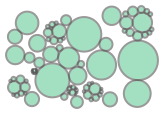

In [70]:
rcp.rad_seq_start=0.55
rcp.rad_seq_end=0.1
rcp.n_rads=80
rcp.run(4, progress_bar=True)
rcp.unfilled_circles

## lattice 1

100%|██████████| 4/4 [00:17<00:00,  4.43s/it]


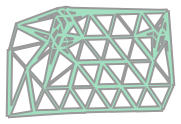

In [71]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.13,
    rad_seq_end=0.13, min_allowed_rad=4, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.8, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [74]:
occluded_tris = tris.intersection(rcp.unfilled_circles)

In [75]:
stp = gp.ScaleTransPrms(d_buffer=-0.2,angles=-45, d_translate_factor=0.65)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [76]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [77]:
layer1 = gp.merge_LineStrings(fills)

In [78]:
all_polys = occluded_tris

## lattice 2

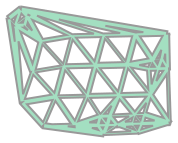

In [79]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.1, 1.7).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [80]:
int_tris = tris.intersection(rcp.unfilled_circles).buffer(0.5)

In [81]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [82]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,d_translate_factor=0.65)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [83]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [84]:
layer2 = gp.merge_LineStrings(fills)

In [85]:
all_polys = so.unary_union([all_polys, occluded_tris])

## lattice3

In [86]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(1)

In [87]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(0.4, 1.2).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [96]:
int_tris = tris.intersection(rcp.unfilled_circles).buffer(5.3)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [97]:
stp = gp.ScaleTransPrms(d_buffer=-0.3,angles=-45,d_translate_factor=0.65)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [98]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [99]:
layer3 = gp.merge_LineStrings(fills)

In [100]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [93]:
mbg = gp.merge_LineStrings([l for l in bg_layers[0] if l.length>0.05])

In [94]:
bg_layer = gp.robust_difference(mbg, all_polys.buffer(1e-6))

In [301]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
sk.stroke(1)
sk.geometry(bg_layer)
for tolerance in [0.1, 0.2, 0.4, 0.8]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-12T00:12:21.368008 
 
 
 
 
 
 <polyline points="358.6533,436.1383 362.2527,439.7269 364.7247,442.2047 365.127,442.2047 362.4606,439.5054 358.6588,435.6566 358.6601,435.5396 362.5283,439.4333 365.2961,442.2047 367.2201,442.2047 363.447,438.4548 358.6814,433.6883 358.6677,434.8832 358.6524,434.8292 358.393,433.3979 358.2005,431.92 358.0271,430.4289 357.8332,428.9521 357.5878,427.5111 357.2681,426.1217 356.8581,424.7951 356.3476,423.5383 355.7321,422.3546 355.012,421.2436 354.193,420.2014 353.2858,419.2205 352.3057,418.2903 351.2715,417.3978 351.1267,417.2799 349.9745,417.3134 350.2705,417.13 351.5967,416.358 352.9438,415.6308 354.3158,414.957 355.7181,414.3482 357.1581,413.8202 358.6442,413.3913 358.9151,413.3365 358.9132,413.5062 362.7986,417.1286 373.898,427.323 385.0573,437.4537 390.3285,442.2047 390.798,442.2047 385.2402,437.2589 374.0415,427.1702 362.9323,416.9862 358.9164,413.2272 358.9251,412.4671 363.3308,416.5617 374.4952,426.687 385.7616,436.7036 392.0332,442.2047 393.2599,442.2047 386.3133,436.1159 375.0489,426.0972 363.8921,415.9638 358.938,411.3477 358.9387,411.2863 357.7421,411.4559 356.2282,411.8253 354.7734,412.3213 353.3677,412.9229 352.0018,413.6098 350.6674,414.3642 349.3575,415.1713 348.0664,416.0187 346.789,416.8954 346.0348,417.4281 346.0275,417.4283 346.2705,417.6515 347.2612,418.5744 348.228,419.5138 349.1527,420.4826 350.0165,421.4936 350.8034,422.5582 351.5016,423.6844 352.1053,424.8763 352.6158,426.1331 353.0409,427.4492 353.3954,428.8144 353.7002,430.2141 353.9822,431.6296 354.2735,433.0388 354.6109,434.4159 355.0344,435.733 355.5852,436.9618 356.3008,438.0759 357.2078,439.0569 358.312,439.9009 358.6081,440.0704 358.6112,439.801 360.4517,441.6453 361.0093,442.2047 359.1102,442.2047 358.5896,441.6842 358.5895,441.6897 358.2292,441.5701 356.7958,440.9551 355.5728,440.1937 354.5821,439.2709 353.8101,438.196 353.223,436.9925 352.7773,435.6907 352.4269,434.3227 352.1276,432.9192 351.8393,431.5079 351.5277,430.1129 351.1645,428.7538 350.728,427.4456 350.2037,426.1985 349.5841,425.0176 348.8695,423.9028 348.067,422.8491 347.1902,421.8471 346.257,420.8843 345.2877,419.9465 344.3021,419.0202 343.3165,418.0938 342.7222,417.5245"/>
 
 
 <polyline points="388.0373,442.2047 384.008,438.5713 372.863,428.4255 361.7914,418.2014 358.8906,415.4747 358.8843,416.0193 358.2591,416.1825 356.7934,416.6553 355.4673,417.1536 354.3418,417.1864 355.1078,417.9538 355.9674,418.9677 356.7276,420.0508 357.3839,421.2062 357.9371,422.4332 358.3923,423.7284 358.7591,425.0851 358.7791,425.1818 358.7777,425.3018 367.6624,433.9648 376.2463,442.2047 376.3717,442.2047 367.7542,433.8671 358.7799,425.1146 358.762,426.6659 367.0483,434.6189 375.0122,442.2047 374.8739,442.2047 366.9841,434.6873 358.7605,426.8032 358.7429,428.3374 366.2039,435.5184 373.1836,442.2047"/>
 
 
 <polyline points="323.3443,414.6808 323.1061,414.6822 321.7161,414.5664 320.2784,414.3154 318.8012,413.9522 317.301,413.5235 315.7988,413.089 314.3169,412.7122 314.068,412.6675 314.0325,412.6735 314.4154,411.3716 314.6987,409.9645 314.7891,408.6115 314.6505,407.3225 314.2655,406.1026 313.6366,404.9509 312.7842,403.8618 311.7442,402.8253 310.5634,401.8282 309.2945,400.8557 307.9906,399.893 306.7,398.9266 305.4612,397.9457 304.2994,396.9433 303.224,395.9167 302.2286,394.8676 301.2929,393.8019 300.3872,392.7277 299.4787,391.6543 298.5399,390.5894 297.5582,389.5366 296.544,388.4928 295.5379,387.4467 295.4571,387.3534 296.6227,386.819 296.8714,387.0734 297.9271,388.1055 298.9765,389.1394 300.0023,390.18 301.0093,391.2258 302.019,392.2708 303.0617,393.3066 304.1691,394.3243 305.3672,395.3166 306.6703,396.2795 308.0774,397.2133 309.5707,398.1229 311.1161,399.0179 312.6652,399.9119 313.4019,400.3603 313.4019,400.3603 314.1594,400.8213 315.5349,401.7639 316.7278,402.7577 317.6805,403.8187 318.3471,404.9598 318.6983,406.1892 318.7257,407.5093 318.4446,408.9157 317.8947,410.3974 317.2321,411.7459 317.2321,411.7

In [101]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
sk.stroke(2)
sk.geometry(layer1)
sk.stroke(3)
sk.geometry(layer2)
sk.stroke(4)
sk.geometry(layer3)
sk.penWidth('0.3')

tolerance=0.1
sk.vpype(f'linesimplify --tolerance {tolerance}')
for tolerance in [0.1, 0.2, 0.4]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesort')
sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-03-25T13:44:14.534648 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="299.5911,87.9985 321.8835,88.5458 321.8347,90.5356 330.1558,90.4583 327.69,92.9091 326.2053,94.0102 322.9489,95.7508 321.2085,96.3735 317.587,97.0939 313.8946,97.0939 312.0662,96.8227 308.5328,95.7508 305.2763,94.0102 302.4221,91.6678 301.1807,90.2982 299.5911,87.9985 298.7125,86.9026 322.8072,87.4941 322.7587,89.4678 331.7077,89.422 329.7777,91.7097 328.3608,92.9939 326.8248,94.133 323.456,95.9338 321.6555,96.578 317.9089,97.3232 314.089,97.3232 312.1974,97.0426 308.5419,95.9338 305.173,94.133 303.6371,92.9939 300.936,90.2928 299.7968,88.7568 298.7125,86.9026"/>
 <polyline points="297.6295,85.612 323.9249,86.2576 323.877,88.2105 328.0643,88.2107 328.0677,88.0687 333.5193,88.2025 331.9696,90.4078 330.63,91.8858 329.152,93.2254 325.8389,95.4392 324.0356,96.292 320.2225,97.4487 318.2494,97.7414 314.2647,97.7414 310.3566,96.964 308.4785,96.292 304.9643,94.4137 301.8841,91.8858 300.5445,90.4078 299.3562,88.8056 297.6295,85.612 296.8838,84.4944 324.8741,85.1815 324.8266,87.1177 327.664,87.1178 327.6679,86.9595 334.9514,87.1383 332.7499,90.4183 331.3658,91.9454 329.8387,93.3295 328.1832,94.5573 326.4154,95.6169 324.5523,96.4981 322.6117,97.1924 320.6124,97.6932 318.5737,97.9956 316.5152,98.0967 314.4566,97.9956 312.4179,97.6932 310.4186,97.1924 308.478,96.4981 306.6149,95.6169 304.8471,94.5573 303.1916,93.3295 301.6645,91.9454 300.2804,90.4183 299.0526,88.7628 297.9931,86.995 296.8838,84.4944 296.0767,83.3064 325.8938,84.0384 325.8467,85.9561 327.1966,85.9562 327.2009,85.7799 336.3882,86.0054 334.8547,88.7583 333.5835,90.4724 332.1503,92.0537 330.569,93.4869 328.8549,94.7581 327.0245,95.8553 325.0953,96.7677 323.0859,97.4867 321.0158,98.0052 318.9048,98.3184 316.7733,98.4231 314.6418,98.3184 312.5308,98.0052 310.4606,97.4867 308.4513,96.7677 306.5221,95.8553 304.6916,94.7581 302.9775,93.4869 301.3962,92.0537 299.9631,90.4724 298.6918,88.7583 297.5947,86.9279 296.0767,83.3064"/>
 
 
 <polyline points="262.7891,96.35 263.6034,95.6829 264.5484,95.1778 265.5738,94.8667 266.6401,94.7617 267.7065,94.8667 268.7318,95.1778 269.6768,95.6829 270.6689,96.5434 262.7891,96.35 261.41,96.7255 262.4431,95.3544 263.9282,94.2529 265.0693,93.7803 266.8982,93.509 268.7272,93.7803 270.3986,94.5708 271.7686,95.8125 272.53,96.9985 261.41,96.7255 260.4824,97.0562 273.9432,97.3867 273.0424,95.4585 271.6473,93.9192 269.8654,92.8512 268.5374,92.4484 267.1563,92.3124 265.1014,92.6172 263.2234,93.5054 261.6842,94.9005 260.9132,96.0544 260.4824,97.0562 259.8155,97.3184 275.083,97.6932 274.8621,96.7141 274.2782,95.3046 273.4306,94.036 272.3518,92.9572 270.3928,91.783 268.9328,91.3402 267.4145,91.1906 265.1553,91.5257 263.7457,92.1096 262.4772,92.9572 260.9434,94.6495 260.2242,95.995 259.8155,97.3184 259.2231,97.604 276.1541,98.0196 276.017,96.8954 275.5328,95.2994 274.7466,93.8285 273.6886,92.5393 272.3993,91.4812 270.9284,90.695 269.3324,90.2108 267.6726,90.0474 265.2029,90.4137 263.662,91.052 262.2752,91.9786 261.0959,93.1579 260.1693,94.5447 259.531,96.0855 259.2231,97.604 258.7879,97.8188 277.0827,98.268 277.0891,98.1372 276.9131,96.3505 276.392,94.6324 275.5456,93.049 274.4067,91.6612 273.0188,90.5222 271.4355,89.6759 269.7174,89.1547 267.9307,88.9787 266.144,89.1547 264.4259,89.6759 262.8425,90.5222 261.4547,91.6612 260.3157,93.049 259.4694,94.6324 258.9482,96.3505 258.7879,97.8188 258.2147,98.2199 278.1379,98.709 278.1394,96.739 277.757,94.8166 277.0069,93.0057 275.9179,91.376 274.5319,89.99 272.9022,88.901 271.0913,88.1509 269.1688,87.7685 267.2087,87.7685 265.2863,88.1509 263.4754,88.901 261.8457,89.99 260.4597,91.376 259.3707,93.0057 258.6206,94.8166 258.2382,96.739 258.2147,98.2199 257.8409,98.4613 278.9759,98.9801 279.0698,96.2547 278.6616,94.2024 277.8608,92.2692 276.6982,90.5293 275.2186,89.0497 273.4787,87.8871 271.5455,87.0864 269.4932,86.6781 267.4006,86.6781 265.3483,87.0864 263.4151,87.8871 261.6752,89.0497 260

In [102]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0315_cpack_beams_postcard.svg'

sk.save(savepath)
